##### Copyright 2020 The TensorFlow Authors.

In [1]:
#@title Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# https://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

# Intro to Autoencoders

<table class="tfo-notebook-buttons" align="left">
  <td>
    <a target="_blank" href="https://www.tensorflow.org/tutorials/generative/autoencoder">
    <img src="https://www.tensorflow.org/images/tf_logo_32px.png" />
    View on TensorFlow.org</a>
  </td>
  <td>
    <a target="_blank" href="https://colab.research.google.com/github/tensorflow/docs/blob/master/site/en/tutorials/generative/autoencoder.ipynb">
    <img src="https://www.tensorflow.org/images/colab_logo_32px.png" />
    Run in Google Colab</a>
  </td>
  <td>
    <a target="_blank" href="https://github.com/tensorflow/docs/blob/master/site/en/tutorials/generative/autoencoder.ipynb">
    <img src="https://www.tensorflow.org/images/GitHub-Mark-32px.png" />
    View source on GitHub</a>
  </td>
  <td>
    <a href="https://storage.googleapis.com/tensorflow_docs/docs/site/en/tutorials/generative/autoencoder.ipynb"><img src="https://www.tensorflow.org/images/download_logo_32px.png" />Download notebook</a>
  </td>
</table>

This tutorial introduces autoencoders with three examples: the basics, image denoising, and anomaly detection.

An autoencoder is a special type of neural network that is trained to copy its input to its output. For example, given an image of a handwritten digit, an autoencoder first encodes the image into a lower dimensional latent representation, then decodes the latent representation back to an image. An autoencoder learns to compress the data while minimizing the reconstruction error. 

To learn more about autoencoders, please consider reading chapter 14 from [Deep Learning](https://www.deeplearningbook.org/) by Ian Goodfellow, Yoshua Bengio, and Aaron Courville.

## Import TensorFlow and other libraries

In [124]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from pathlib import Path
import tensorflow as tf
from libtiff import TIFF
import libtiff
import operator

from sklearn.metrics import accuracy_score, precision_score, recall_score, balanced_accuracy_score
from sklearn.model_selection import train_test_split
from tensorflow.keras import layers, losses
from tensorflow.keras.datasets import fashion_mnist
from tensorflow.keras.models import Model

## Load the dataset
To start, you will train the basic autoencoder using the Fashon MNIST dataset. Each image in this dataset is 28x28 pixels. 

In [3]:
data_dir = Path("/home/maximl/data/EhV_infection/images/")

In [4]:
image_count = len(list(data_dir.glob("H1_T[7,8]/*Ch1.*")))
image_count

20474

In [5]:
def cropND(img, bounding):
  
    # compute possibly necessary padding widths
    padding = tuple(map(lambda a,b: abs(min(0, b-a)), bounding, img.shape))
    if sum(padding) > 0:
      
        # split padding into before and after part
        before_after = tuple(map(lambda a: (a//2, (a//2)+(a%2)), padding))
        img = np.pad(
            array=img,
            pad_width=before_after,
            mode="edge"
        )
        
    start = tuple(map(lambda a, da: a//2-da//2, img.shape, bounding))
    end = tuple(map(operator.add, start, bounding))
    slices = tuple(map(slice, start, end))
    return img[slices]

In [139]:
def process_path(paths):
    img = np.empty(shape=(28,28, len(paths)))
    
    for i, path in enumerate(paths):
        x = TIFF.open(path)
        x = x.read_image().astype("float32")
        x = x / 2**12
        img[..., i] = cropND(x, (28, 28))
    
    return img

In [140]:
%%time
libtiff.libtiff_ctypes.suppress_warnings()
x_train = list(map(process_path, zip(data_dir.glob("H1_T[7,8]/*Ch1.*"), data_dir.glob("H1_T[7,8]/*Ch6.*"), data_dir.glob("H1_T[7,8]/*Ch7.*"))))

TIFFFetchNormalTag: Incorrect count for "SubfileType"; tag ignored.
_TIFFVSetField: /home/maximl/data/EhV_infection/images/H1_T7/0_Ch1.ome.tif: Bad value 0 for "FillOrder" tag.
TIFFFetchNormalTag: Incorrect count for "XResolution"; tag ignored.
TIFFFetchNormalTag: Incorrect count for "YResolution"; tag ignored.
TIFFFetchNormalTag: Incorrect count for "SubfileType"; tag ignored.
_TIFFVSetField: /home/maximl/data/EhV_infection/images/H1_T7/0_Ch6.ome.tif: Bad value 0 for "FillOrder" tag.
TIFFFetchNormalTag: Incorrect count for "XResolution"; tag ignored.
TIFFFetchNormalTag: Incorrect count for "YResolution"; tag ignored.
TIFFFetchNormalTag: Incorrect count for "SubfileType"; tag ignored.
_TIFFVSetField: /home/maximl/data/EhV_infection/images/H1_T7/0_Ch7.ome.tif: Bad value 0 for "FillOrder" tag.
TIFFFetchNormalTag: Incorrect count for "XResolution"; tag ignored.
TIFFFetchNormalTag: Incorrect count for "YResolution"; tag ignored.
TIFFFetchNormalTag: Incorrect count for "SubfileType"; tag ig

CPU times: user 41 s, sys: 15.6 s, total: 56.6 s
Wall time: 41.8 s


Incorrect count for "XResolution"; tag ignored.
TIFFFetchNormalTag: Incorrect count for "YResolution"; tag ignored.
TIFFFetchNormalTag: Incorrect count for "SubfileType"; tag ignored.
_TIFFVSetField: /home/maximl/data/EhV_infection/images/H1_T8/9885_Ch6.ome.tif: Bad value 0 for "FillOrder" tag.
TIFFFetchNormalTag: Incorrect count for "XResolution"; tag ignored.
TIFFFetchNormalTag: Incorrect count for "YResolution"; tag ignored.
TIFFFetchNormalTag: Incorrect count for "SubfileType"; tag ignored.
_TIFFVSetField: /home/maximl/data/EhV_infection/images/H1_T8/9885_Ch7.ome.tif: Bad value 0 for "FillOrder" tag.
TIFFFetchNormalTag: Incorrect count for "XResolution"; tag ignored.
TIFFFetchNormalTag: Incorrect count for "YResolution"; tag ignored.
TIFFFetchNormalTag: Incorrect count for "SubfileType"; tag ignored.
_TIFFVSetField: /home/maximl/data/EhV_infection/images/H1_T8/9887_Ch1.ome.tif: Bad value 0 for "FillOrder" tag.
TIFFFetchNormalTag: Incorrect count for "XResolution"; tag ignored.
TIFF

In [8]:
libtiff.libtiff_ctypes.suppress_warnings()
x_test = list(map(process_path, data_dir.glob("H1_T9/*Ch1.*")))

TIFFFetchNormalTag: Incorrect count for "SubfileType"; tag ignored.
_TIFFVSetField: /home/maximl/data/EhV_infection/images/H1_T9/10001_Ch1.ome.tif: Bad value 0 for "FillOrder" tag.
TIFFFetchNormalTag: Incorrect count for "XResolution"; tag ignored.
TIFFFetchNormalTag: Incorrect count for "YResolution"; tag ignored.
TIFFFetchNormalTag: Incorrect count for "SubfileType"; tag ignored.
_TIFFVSetField: /home/maximl/data/EhV_infection/images/H1_T9/10002_Ch1.ome.tif: Bad value 0 for "FillOrder" tag.
TIFFFetchNormalTag: Incorrect count for "XResolution"; tag ignored.
TIFFFetchNormalTag: Incorrect count for "YResolution"; tag ignored.
TIFFFetchNormalTag: Incorrect count for "SubfileType"; tag ignored.
_TIFFVSetField: /home/maximl/data/EhV_infection/images/H1_T9/10005_Ch1.ome.tif: Bad value 0 for "FillOrder" tag.
TIFFFetchNormalTag: Incorrect count for "XResolution"; tag ignored.
TIFFFetchNormalTag: Incorrect count for "YResolution"; tag ignored.
TIFFFetchNormalTag: Incorrect count for "SubfileT

In [147]:
x_train = tf.stack(x_train)
x_test = tf.stack(x_test)

In [148]:
x_train.shape

TensorShape([20474, 28, 28, 3])

In [11]:
x_test.shape

TensorShape([14675, 28, 28])

Adding random noise to the images

In [12]:
x_train = x_train[..., tf.newaxis]
x_test = x_test[..., tf.newaxis]

In [13]:
noise_factor = 0.05
x_train_noisy = x_train + noise_factor * tf.random.normal(shape=x_train.shape, stddev=0.05) 
x_test_noisy = x_test + noise_factor * tf.random.normal(shape=x_test.shape, stddev=0.05)

x_train_noisy = tf.clip_by_value(x_train_noisy, clip_value_min=0., clip_value_max=1.)
x_test_noisy = tf.clip_by_value(x_test_noisy, clip_value_min=0., clip_value_max=1.)

Plot the noisy images.


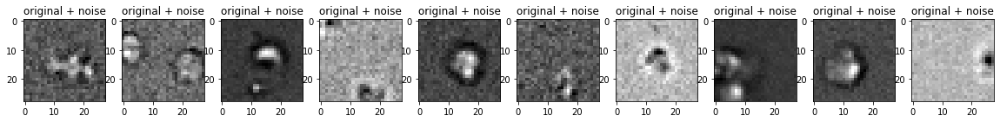

In [14]:
n = 10
plt.figure(figsize=(20, 2))
for i in range(n):
    ax = plt.subplot(1, n, i + 1)
    plt.title("original + noise")
    plt.imshow(tf.squeeze(x_test_noisy[i]))
    plt.gray()
plt.show()

### Define a convolutional autoencoder

In this example, you will train a convolutional autoencoder using  [Conv2D](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Conv2D) layers in the `encoder`, and [Conv2DTranspose](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Conv2DTranspose) layers in the `decoder`.

In [15]:
class Denoise(Model):
    def __init__(self, latent_dim):
        super(Denoise, self).__init__()
        self.encoder = tf.keras.Sequential([
            layers.Input(shape=(28, 28, 1)),
            layers.Conv2D(16, (3, 3), activation='relu', padding='same', strides=2),
            layers.Conv2D(8, (3, 3), activation='relu', padding='same', strides=2),
            layers.Flatten(),
            layers.Dense(latent_dim)
        ])

        self.decoder = tf.keras.Sequential([
            layers.Dense(7*7*8),
            layers.Reshape((7,7,8)),
            layers.Conv2DTranspose(8, kernel_size=3, strides=2, activation='relu', padding='same'),
            layers.Conv2DTranspose(16, kernel_size=3, strides=2, activation='relu', padding='same'),
            layers.Conv2D(1, kernel_size=(3, 3), activation='sigmoid', padding='same')
        ])

    def call(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

autoencoder = Denoise(128)

In [16]:
autoencoder.compile(optimizer='adam', loss=losses.MeanSquaredError())

In [31]:
history = autoencoder.fit(x_train_noisy, x_train,
                epochs=50,
                shuffle=True,
                validation_data=(x_test_noisy, x_test))

Epoch 1/50
640/640 [==============================] - 5s 7ms/step - loss: 4.4260e-05 - val_loss: 3.7618e-05
Epoch 2/50
640/640 [==============================] - 5s 7ms/step - loss: 4.2968e-05 - val_loss: 4.0462e-05
Epoch 3/50
640/640 [==============================] - 5s 7ms/step - loss: 4.0177e-05 - val_loss: 3.4442e-05
Epoch 4/50
640/640 [==============================] - 5s 7ms/step - loss: 3.8220e-05 - val_loss: 3.3780e-05
Epoch 5/50
640/640 [==============================] - 5s 8ms/step - loss: 3.7512e-05 - val_loss: 3.3513e-05
Epoch 6/50
640/640 [==============================] - 5s 7ms/step - loss: 3.7194e-05 - val_loss: 3.3351e-05
Epoch 7/50
640/640 [==============================] - 5s 8ms/step - loss: 3.6537e-05 - val_loss: 3.2529e-05
Epoch 8/50
640/640 [==============================] - 4s 7ms/step - loss: 3.3779e-05 - val_loss: 2.9024e-05
Epoch 9/50
640/640 [==============================] - 5s 8ms/step - loss: 3.1547e-05 - val_loss: 2.7259e-05
Epoch 10/50
640/640 [=======

Plotting both the noisy images and the denoised images produced by the autoencoder.

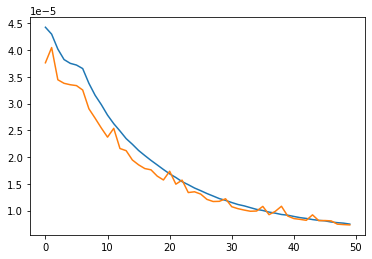

In [32]:
plt.plot(history.epoch, history.history["loss"])
plt.plot(history.epoch, history.history["val_loss"])

In [33]:
encoded_imgs = autoencoder.encoder(x_test).numpy()
decoded_imgs = autoencoder.decoder(encoded_imgs).numpy()

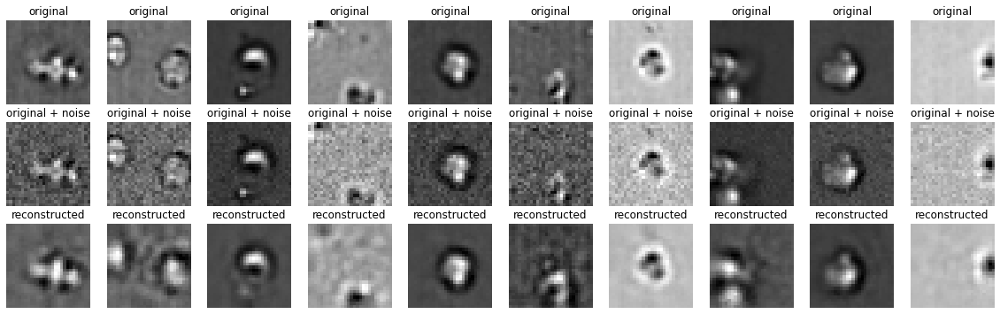

In [34]:
n = 10
fig, axes = plt.subplots(3, n, figsize=(20, 6))
for i in range(n):
    
    # display original
    ax = axes[0, i]
    ax.set_title("original")
    ax.imshow(tf.squeeze(x_test[i]), cmap="gray")
    ax.set_axis_off()

    # display original + noise
    ax = axes[1, i]
    ax.set_title("original + noise")
    ax.imshow(tf.squeeze(x_test_noisy[i]), cmap="gray")
    ax.set_axis_off()

    # display reconstruction
    ax = axes[2, i]
    ax.set_title("reconstructed")
    ax.imshow(tf.squeeze(decoded_imgs[i]), cmap="gray")
    ax.set_axis_off()
    
plt.show()

In [35]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

In [36]:
encoded_imgs_standard = StandardScaler().fit_transform(encoded_imgs)
embedding = PCA(n_components=0.95).fit_transform(encoded_imgs_standard)

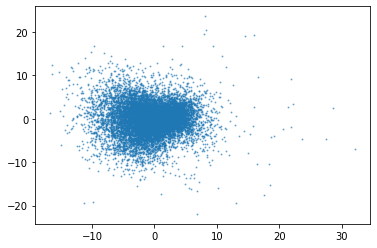

In [37]:
plt.scatter(embedding[:, 0], embedding[:, 1], s=1, alpha=0.5)

In [38]:
import umap

In [39]:
embedding_umap = umap.UMAP(n_components=2).fit_transform(encoded_imgs_standard)

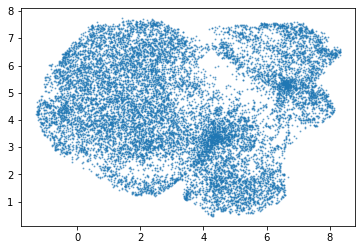

In [109]:
plt.scatter(embedding_umap[:, 0], embedding_umap[:, 1], s=1, alpha=0.5)

In [41]:
corr = np.corrcoef(encoded_imgs, rowvar=False)

In [42]:
import seaborn

/srv/scratch/maximl/anaconda3/envs/py38tf/lib/python3.8/site-packages/seaborn/matrix.py:649: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


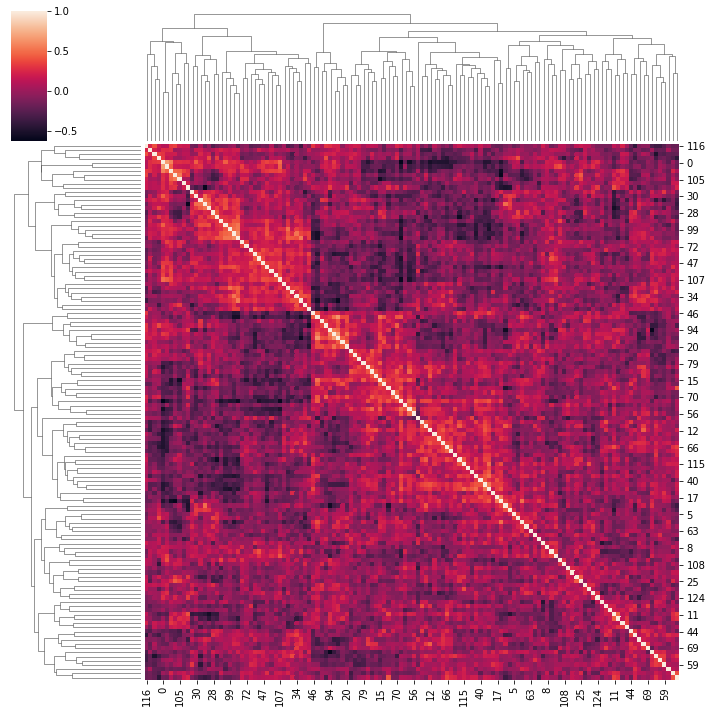

In [43]:
seaborn.clustermap(corr)

# Classification with autoencoder features

In [30]:
from ehv import load

In [97]:
df = pd.read_csv("/home/maximl/projects/weizmann-ehv-metadata/cell_populations/manual_gating/High/H1_T9_10.csv", index_col="Object Number")

In [98]:
paths = list(data_dir.glob("H1_T9/*Ch1.*"))

In [99]:
encoded_imgs_standard.shape

(14675, 128)

In [100]:
objectnumbers = list(int(p.stem.split("_")[0]) for p in paths)

In [101]:
df2 = pd.DataFrame(index=objectnumbers, data=encoded_imgs_standard)
df2.index.name = "Object Number"

In [ ]:
df = df2.join(df)

In [113]:
X = df.iloc[:,:128]
y = df.drop(columns=X.columns)

In [110]:
from sklearn.ensemble import RandomForestClassifier

In [122]:
X_train, X_test, y_train, y_test = train_test_split(X, y.drop(columns="COI"), test_size=0.33, random_state=42)

In [135]:
rf = RandomForestClassifier(n_estimators=500)
rf.fit(X_train.values, y_train.values)

RandomForestClassifier(n_estimators=500)

In [136]:
y_pred = rf.predict(X_test)

In [138]:
balanced_accuracy_score(y_test.values.argmax(axis=1), y_pred.argmax(axis=1), adjusted=True)

0.008139272300567027